In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob
import pickle

from moviepy.editor import VideoFileClip
from IPython.display import HTML

# Camera calibration and pickle the parameters

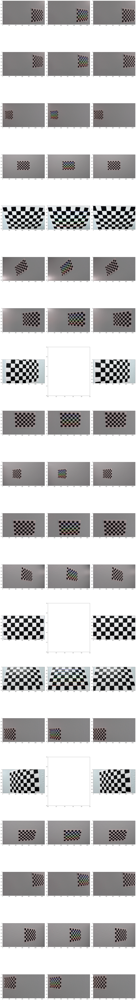

In [12]:
# prepare object points
nx = 9#TODO: enter the number of inside corners in x
ny = 6#TODO: enter the number of inside corners in y
#list of images in path
imgList=glob.glob('..//CarND-Advanced-Lane-Lines//camera_cal//*.jpg')
#print(imgList)
# Make a list of calibration images
actualPoints=np.zeros((nx*ny,3),np.float32)
actualPoints[:,:2]=np.mgrid[0:nx,0:ny].T.reshape(-1,2)
checkerPointsList=[]
actualPointsList=[]
f, ax = plt.subplots(len(imgList), 3, figsize=(24, 9*len(imgList)))
f.tight_layout()
for i,fname in enumerate(imgList):
#fname = 'calibration10-Copy1.jpg'
    img = cv2.imread(fname)

    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    ax[i,0].imshow(img)
    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)
    #print(ret)
    # If found, draw corners
    if ret == True:
        # Draw and display the corners
        cv2.drawChessboardCorners(img, (nx, ny), corners, ret)
        ax[i,1].imshow(img)
        checkerPointsList.append(corners)
        actualPointsList.append(actualPoints)

#calibrate camera
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(actualPointsList, checkerPointsList, gray.shape[::-1], None, None)
#undistort sample image
for i,fname in enumerate(imgList):
    img = cv2.imread(fname)
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    ax[i,2].imshow(dst)
#plt.imshow(dst)
#plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
pickling_on = open("cameraCalib.p","wb")
loadToPickle={}
loadToPickle["mtx"]=mtx
loadToPickle["dist"]=dist
pickle.dump(loadToPickle,pickling_on)
pickling_on.close()

#  Functions for thresholding and Prespective transform

In [2]:
# Sobel tresholding function
def abs_sobel_thresh(img, orient='x',thresh_min=0, thresh_max=255):
    
    # Apply the following steps to img
    # 1) Convert to grayscale
    #grayImg=cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
    grayImg=img
    # 2) Take the derivative in x or y given orient = 'x' or 'y'
    if orient=='x':
        sobelx = cv2.Sobel(grayImg, cv2.CV_64F, 1, 0)
    else:
        sobelx = cv2.Sobel(grayImg, cv2.CV_64F, 0, 1)        
    # 3) Take the absolute value of the derivative or gradient
    sobelx=np.absolute(sobelx)
    # 4) Scale to 8-bit (0 - 255) then convert to type = np.uint8
    sobelx = np.uint8(255*sobelx/np.max(sobelx))
    sobelx= thresholder(sobelx, thresh_min, thresh_max)
    return sobelx

# This function applies tresholds on given image and return binary image
def thresholder(img, thresh_min=0, thresh_max=255):
     #Create a mask of 1's where the scaled gradient magnitude 
            # is > thresh_min and < thresh_max
    sxbinary = np.zeros_like(img)
    sxbinary[(img >= thresh_min) & (img <= thresh_max)] = 1
    # 6) Return this mask as your binary_output image
    binary_output = np.copy(sxbinary) # Remove this line
    return binary_output

#Prespective transformation function
def prespectivetransformer(img):
        #src = np.array([[225,800],[575,450],[750,450],[1150,800]],dtype=np.float32)
        #src = np.array([[225,800],[225,450],[1150,450],[1150,800]],dtype=np.float32)
        # c) define 4 destination points dst = np.float32([[,],[,],[,],[,]])
        #dst = np.float32([[200,800],[200,0],[1100,0],[1100,800]])
        #src = np.array([[225,650],[600,450],[750,450],[1150,650]],dtype=np.float32)
        # c) define 4 destination points dst = np.float32([[,],[,],[,],[,]])
        #dst = np.float32([[225,650],[225,0],[1150,0],[1150,650]])
        h,w = img.shape[:2]
        src = np.float32([(575,464),
                  (707,464), 
                  (258,682), 
                  (1049,682)])
        dst = np.float32([(450,0),
                  (w-450,0),
                  (450,h),
                  (w-450,h)])
        #dst = np.float32([[450,800],[450,0],[950,0],[950,800]])
                #dst = np.float32([(450,h),(450,0),(w-450,0),(w-450,h)])
        # d) use cv2.getPerspectiveTransform() to get M, the transform matrix
        M=cv2.getPerspectiveTransform(src,dst)
        Minv = cv2.getPerspectiveTransform(dst, src)
        # e) use cv2.warpPerspective() to warp your image to a top-down view
        img_size=(img.shape[1],img.shape[0])
        warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
        return warped,Minv

    
    
# image undistortion function
def undistorter(img):
    undistImg = cv2.undistort(img, mtx, dist, None, mtx)
    return undistImg


            
                

# Compile the preprocessing pipeline as single function(level1)

In [3]:
# Load camera caliberation parameters from the pickle file
dist_pickle = pickle.load( open( "cameraCalib.p", "rb" ) )
mtx = dist_pickle["mtx"]
dist = dist_pickle["dist"]

##f, ax = plt.subplots(1, 2, figsize=(24, 9*2))
#f.tight_layout()
# pre-Processing sequence
def level1_Process(fname):
    #fname = 'test1-Copy1.jpg'
    #Mainimg = mpimg.imread(fname)
    Mainimg=fname
    
    #1.Undistort
    MainimgUD=undistorter(Mainimg)
    #ax[1].imshow(MainimgUD)
    #ax[1].set_title('Undistored Image')
    #plt.imshow(MainimgUD)
    
    #2.Prespective transform
    [Mainimg,Minv]=prespectivetransformer(MainimgUD)
    #ax[0].imshow(MainimgUD)
    #ax[0].set_title('Orginal Image',fontsize=50)
    
    #print(Mainimg.shape)
    
    #3.Gradient & tresholding

    MainimgChanl=cv2.cvtColor(Mainimg,cv2.COLOR_RGB2HLS)
    MainimgRChanl=MainimgChanl[:,:,1]
    
    sobelR=thresholder(MainimgRChanl,thresh_min=200,thresh_max=255)
   
    #plt.imshow(MainimgRChanl,cmap='gray')
    #img=cv2.cvtColor(Mainimg,cv2.COLOR_RGB2HLS)
    #sobel_output=abs_sobel_thresh(img, orient='x')
    MainimgsChanl=MainimgChanl[:,:,2]
    sChan_Bin=thresholder(MainimgsChanl, thresh_min=40, thresh_max=250)
    
    #plt.imshow(sChan_Bin,cmap='gray')
    MainimghChanl=MainimgChanl[:,:,0]
    #plt.imshow(MainimghChanl,cmap='gray')
    hChan_Bin=thresholder(MainimghChanl, thresh_min=20, thresh_max=40)
    #ax[1].imshow(MainimghChanl,cmap='gray')
    #ax[1].set_title('H channel',fontsize=50)
    #ax[2].imshow(hChan_Bin,cmap='gray')
    #ax[2].set_title('H channel Thresh',fontsize=50)
    #plt.imshow(hChan_Bin,cmap='gray')
    #finalout=np.zeros_like(sobel_Bin)
    finalout=((sChan_Bin & hChan_Bin) | sobelR)  
    #plt.imshow(finalout,cmap='gray')|
    return finalout,Minv

# Sample testing
fname = '..//CarND-Advanced-Lane-Lines//test_images//straight_lines1.jpg'
#fname = '..//CarND-Advanced-Lane-Lines//camera_cal//calibration1.jpg'
#/CarND-Advanced-Lane-Lines/camera_cal
fname = mpimg.imread(fname)
#fname=processed_video
[finalout,Minv]=level1_Process(fname)
#ax[1].imshow(finalout,cmap='gray')
#ax[1].set_title('Combined Out',fontsize=50)

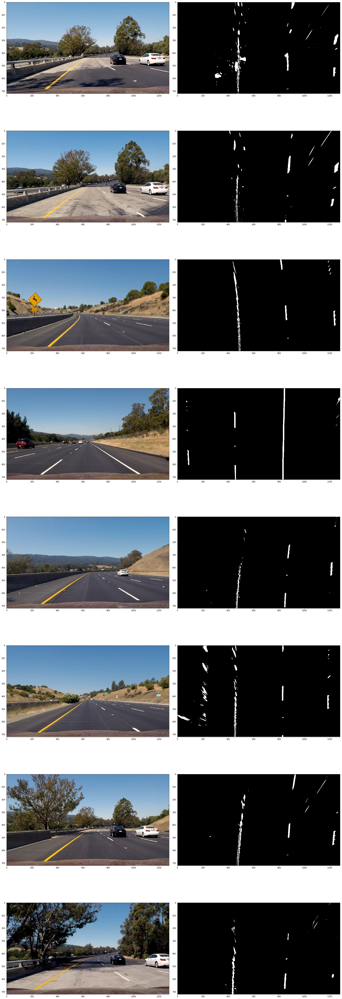

In [4]:
# testing on n image samples
imgList=glob.glob('..//CarND-Advanced-Lane-Lines//test_images//*.jpg')

f, ax = plt.subplots(len(imgList), 2, figsize=(24, 9*len(imgList)))
f.tight_layout()
for i,fname in enumerate(imgList):
    #print(fname)
    fname = mpimg.imread(fname)
    [finalout,Minv]=level1_Process(fname)
    #imgtemp=mpimg.imread(fname)
    ax[i,0].imshow(fname)
    ax[i,1].imshow(finalout,cmap='gray')

#  Functions for sliding window and tracking of Lane

In [5]:
# Lane marking indentification function using convolution(not used in main pipeline)
def find_window_centroids(image, window_width, window_height, margin):
    
    window_centroids = [] # Store the (left,right) window centroid positions per level
    window = np.ones(window_width) # Create our window template that we will use for convolutions
    
    # First find the two starting positions for the left and right lane by using np.sum to get the vertical image slice
    # and then np.convolve the vertical image slice with the window template 
    
    # Sum quarter bottom of image to get slice, could use a different ratio
    #l_sum = np.sum(image[int(3*image.shape[0]/4):,int(image.shape[1]/4):int(2*image.shape[1]/4)], axis=0)
    #l_center = np.argmax(np.convolve(window,l_sum))-window_width/2+int(image.shape[1]/4)
    #r_sum = np.sum(image[int(3*image.shape[0]/4):,int(2*image.shape[1]/4):int(3*image.shape[1]/4)], axis=0)
    #r_center = np.argmax(np.convolve(window,r_sum))-window_width/2+int(2*image.shape[1]/4)
    
    l_sum = np.sum(image[int(2*image.shape[0]/4):,:int(image.shape[1]/2)], axis=0)
    l_center = np.argmax(np.convolve(window,l_sum))-window_width/2
    r_sum = np.sum(image[int(2*image.shape[0]/4):,int(image.shape[1]/2):], axis=0)
    r_center = np.argmax(np.convolve(window,r_sum))-window_width/2+int(image.shape[1]/2)
    
    l_center_old=l_center
    r_center_old=r_center
    # Add what we found for the first layer
    window_centroids.append((l_center,r_center))
    windowL=[]
    windowR=[]
    # Go through each layer looking for max pixel locations
    for level in range(1,(int)(image.shape[0]/window_height)):
        # convolve the window into the vertical slice of the image
        #image_layer = np.sum(image[int(image.shape[0]-(level+1)*window_height):int(image.shape[0]-level*window_height),:], axis=0)
        image_layer = np.sum(image[int(image.shape[0]-(level+1)*window_height):int(image.shape[0]-level*window_height),:], axis=0)
        conv_signal = np.convolve(window, image_layer,'same')
        # Find the best left centroid by using past left center as a reference
        # Use window_width/2 as offset because convolution signal reference is at right side of window, not center of window
        offset = 0
        l_min_index = int(max(l_center+offset-margin,0))
        l_max_index = int(min(l_center+offset+margin,image.shape[1]))
        l_center = np.argmax(conv_signal[l_min_index:l_max_index])+l_min_index-offset
        #print(l_center)
        if l_center==l_min_index-offset:
            l_center=l_center_old
        else:
            #l_center=l_center_old
            l_center_old=l_center
        # Find the best right centroid by using past right center as a reference
        r_min_index = int(max(r_center+offset-margin,0))
        r_max_index = int(min(r_center+offset+margin,image.shape[1]))
        r_center = np.argmax(conv_signal[r_min_index:r_max_index])+r_min_index-offset
        if r_center==r_min_index-offset:
            r_center=r_center_old
        else:
            #r_center=r_center_old
            r_center_old=r_center
        # Add what we found for that layer
        l_centerX=l_center
        l_centerY=int((image.shape[0]-(level+1)*window_height) + (window_height/2))
        r_centerX=r_center
        r_centerY=int((image.shape[0]-(level+1)*window_height) + (window_height/2))
        
        window_centroids.append((l_center,r_center))
        windowL.append([l_centerX,l_centerY])
        windowR.append([r_centerX,r_centerY])
    return window_centroids,windowL,windowR

# helper function for plotting of rectangles, called in find lane pixels function
def window_mask(width, height, img_ref, center,level):
    output = np.zeros_like(img_ref)
    output[int(img_ref.shape[0]-(level+1)*height):int(img_ref.shape[0]-level*height),max(0,int(center-width/2)):min(int(center+width/2),img_ref.shape[1])] = 1
    return output

# Function for equation fitting(not used)
def  equationFitting(windowL,windowR):
    leftPoints=windowL
    #print(leftPoints)
    rightPoint=windowR
    leftEq=np.polyfit(leftPoints[:,1],leftPoints[:,0],2)
    rightEq=np.polyfit(rightPoint[:,1],rightPoint[:,0],2)
    return leftEq,rightEq

# function defined to remove pixels other than ROI, kind of region masking
def jugadIdea(img):
    jugadImg=np.zeros_like(img)
    h,w = img.shape[:2]
    dst = np.array([(450,0),
                  (w-450,0),
                  (450,h),
                  (w-450,h)],dtype=np.int)
    nonzeroInds=img.nonzero()
    #print(dst[0,0])
    #print(nonzeroInds[1])
    x=np.array(nonzeroInds[1])
    y=np.array(nonzeroInds[0])
    #print(x[((x>400) & (x<500))])
    #print(  ((nonzeroInds[1]>dst[0,0]) & (nonzeroInds[1]<dst[3,0])))
    
    inds=((x>dst[0,0]-100) & (x<dst[3,0]+100) & (y>dst[0,1]) & (y<dst[3,1])).nonzero()[0]
    #print(nonzerox.shape)
    #print(nonzeroy.shape)
    jugadImg[y[inds],x[inds]]=1
    return jugadImg

#finalouty=jugadIdea(finalout)

# Sliding window function 
def find_lane_pixels(binary_warped):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    qp=0
    leftx_base = np.argmax(histogram[qp:midpoint])+qp
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        ### TO-DO: Find the four below boundaries of the window ###
        win_xleft_low = leftx_current - margin  # Update this
        win_xleft_high = leftx_current + margin  # Update this
        win_xright_low = rightx_current  - margin  # Update this
        win_xright_high = rightx_current + margin  # Update this
        
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),
        (win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),
        (win_xright_high,win_y_high),(0,255,0), 2) 
        
        ### TO-DO: Identify the nonzero pixels in x and y within the window ###
        good_left_inds = ((nonzeroy>=win_y_low) & (nonzeroy<win_y_high) & 
        (nonzerox>=win_xleft_low) & (nonzerox<win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy>=win_y_low) & 
        (nonzeroy<win_y_high) & (nonzerox>=win_xright_low) & (nonzerox<win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        ### TO-DO: If you found > minpix pixels, recenter next window ###
        ### (`right` or `leftx_current`) on their mean position ###
        if len(good_left_inds)>=minpix:
            leftx_current=np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds)>=minpix:
            rightx_current=np.int(np.mean(nonzerox[good_right_inds]))
        #pass # Remove this when you add your function

    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    leftEq, rightEq = (None, None)
    if len(leftx) > 0:
        leftEq=np.polyfit(lefty,leftx,2)
    if len(rightx)>0:
        rightEq=np.polyfit(righty,rightx,2)
    
    return leftx, lefty, rightx, righty, out_img,leftEq,rightEq,left_lane_inds,right_lane_inds

# Function to use previous fitted equation on the new image
def use_Prev_Fitting(img,left_fit,right_fit):
    # HYPERPARAMETER
    # Choose the width of the margin around the previous polynomial to search
    # The quiz grader expects 100 here, but feel free to tune on your own!
    margin = 100
    out_img = np.dstack((img, img, img))
    # Grab activated pixels
    nonzero = img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    ### TO-DO: Set the area of search based on activated x-values ###
    ### within the +/- margin of our polynomial function ###
    ### Hint: consider the window areas for the similarly named variables ###
    ### in the previous quiz, but change the windows to our new search area ###
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
                    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
                    left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
                    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
                    right_fit[1]*nonzeroy + right_fit[2] + margin)))
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    leftEq, rightEq = (None, None)
    if len(leftx) > 0:
        leftEq=np.polyfit(lefty,leftx,2)
    if len(rightx)>0:
        rightEq=np.polyfit(righty,rightx,2)
    
    return leftx, lefty, rightx, righty,out_img,leftEq,rightEq,left_lane_inds,right_lane_inds

# function to calculate curvature and Lateral offset
def get_Curv_latDist(img,leftEq,rightEq,left_lane_inds,right_lane_inds):
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 3/100 # meters per pixel in y dimension, lane line is 10 ft = 3.048 meters
    xm_per_pix = 3.7/390
    nonZeros=img.nonzero()
    nonZeroX=nonZeros[1]
    nonZeroY=nonZeros[0]
    leftx=nonZeroX[left_lane_inds]
    lefty=nonZeroY[left_lane_inds]
    
    rightx=nonZeroX[right_lane_inds]
    righty=nonZeroY[right_lane_inds]
    if len(leftx) != 0 and len(rightx) != 0:
        leftEqCr=np.polyfit(lefty*ym_per_pix,leftx*xm_per_pix,2)
        rightEqCr=np.polyfit(righty*ym_per_pix,rightx*xm_per_pix,2)
        y_eval = img.shape[0]-1

        # Calculation of R_curve (radius of curvature)
        left_curverad = ((1 + (2*leftEqCr[0]*y_eval*ym_per_pix + leftEqCr[1])**2)**1.5) / np.absolute(2*leftEqCr[0])
        right_curverad = ((1 + (2*rightEqCr[0]*y_eval*ym_per_pix + rightEqCr[1])**2)**1.5) / np.absolute(2*rightEqCr[0])
    else:
        left_curverad=0
        right_curverad=0
        
    h=img.shape[0]
    carPos = img.shape[1]/2
    leftInt=leftEq[0]*(h**2) + leftEq[1]*h + leftEq[2]
    rightInt=rightEq[0]*(h**2) + rightEq[1]*h + rightEq[2]
    LC=abs(leftInt+rightInt)/2
    devDist=(carPos-LC)*xm_per_pix
    
    return left_curverad,right_curverad,devDist

# functions to overlay the lane on actual image
def lane_Overlay(img, finalout, leftEq, rightEq, Minv):
    # Create an image to draw the lines on
    zeroPlane = np.zeros_like(finalout)
    colorPlane = np.dstack((zeroPlane, zeroPlane, zeroPlane))*255
    
    h,w = finalout.shape
    ploty = np.linspace(0, h-1, num=h)# to cover same y-range as image
    left_fitx = leftEq[0]*ploty**2 + leftEq[1]*ploty + leftEq[2]
    right_fitx = rightEq[0]*ploty**2 + rightEq[1]*ploty + rightEq[2]

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(colorPlane, np.int_([pts]), (0,255, 0))
    cv2.polylines(colorPlane, np.int32([pts_left]), isClosed=False, color=(255,0,255), thickness=15)
    cv2.polylines(colorPlane, np.int32([pts_right]), isClosed=False, color=(0,255,255), thickness=15)

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarpInverted = cv2.warpPerspective(colorPlane, Minv, (w, h)) 
    # Combine the result with the original image
    result = cv2.addWeighted(img, 1, newwarpInverted, 0.5, 0)
    return result
    
# this function draws the given string on image
def text_Draw(img,left_curverad,right_curverad,latOff=0):
    cur=(left_curverad+right_curverad)/2
    font = cv2.FONT_HERSHEY_DUPLEX
    text = 'Curve radius: ' + '{:04.2f}'.format(cur) + 'm'
    cv2.putText(img, text, (40,70), font, 1.5, (200,255,155), 2, cv2.LINE_AA)
    #text = 'Curve radius: ' + '{:04.2f}'.format(right_curverad) + 'm'
    #cv2.putText(img, text, (40,150), font, 1.5, (200,255,155), 2, cv2.LINE_AA)
    if latOff>0:
        direcn='Right'
    elif latOff<0:
        direcn='Left'
    else:
        direcn=''
    text = 'Offset from LaneCenter: ' + '{:04.2f}'.format(abs(latOff)) + 'm ' + direcn
    cv2.putText(img, text, (40,150), font, 1.5, (200,255,155), 2, cv2.LINE_AA)
    return img


# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None 
        #polynomial coefficients for the most recent fit
        self.current_fit = []  
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        #x values for detected line pixels
        self.allx = []  
        #y values for detected line pixels
        self.ally = None  
    
    #Validator validates based on differnece in prev and new equation
    def validator(self,lineEq,detectinds):
        if lineEq is not None:
            if self.best_fit is not None:
                self.diffs=abs(lineEq-self.best_fit)
            if (self.diffs[0]>0.001 or self.diffs[1]>1 or self.diffs[2]>100) and (len(self.best_fit)>0):
                self.detected = False
            else:
                self.detected = True
                self.current_fit.append(lineEq)
                self.recent_xfitted=detectinds
                #self.allx .append=detectinds
                
                if len(self.current_fit)>10:
                    self.current_fit=self.current_fit[len(self.current_fit)-10:]
                    #self.allx =self.allx [len(self.allx )-5:]
                
                # smoothing of best fit
                self.best_fit=np.average(self.current_fit,axis=0)
        else:
            self.detected = False
            self.best_fit=np.average(self.current_fit,axis=0)
            
                

# final pipeline for Lane tracking

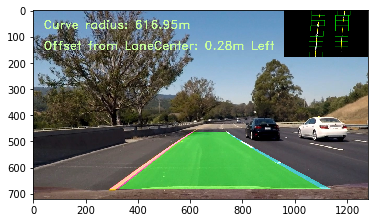

In [6]:
leftLine=Line()
rightLine=Line()
#f, ax = plt.subplots(1, 2, figsize=(24, 9*2))
#f.tight_layout()
def finalpipline(img):
    # Step1: level1 processing
    [finalout,Minv]=level1_Process(img)
    finalout=jugadIdea(finalout)
    # Step2: identification if lanes
    # If lanes are not detected in prev window or if this the first image
    if not leftLine.detected or not rightLine.detected:
        #print("i m here")
        [leftx, lefty, rightx, righty, out_img,leftEq,rightEq,left_lane_inds,right_lane_inds]=find_lane_pixels(finalout)
        #plt.imshow(out_img)
    #if a previous fitted equaiion is available
    else:
        #print("i m here too")
        [leftx, lefty, rightx, righty,out_img,leftEq,rightEq,left_lane_inds,right_lane_inds]=use_Prev_Fitting(finalout,leftLine.best_fit
                                                                                                              ,rightLine.best_fit)
    #print(left_lane_inds.shape)
    #print(right_lane_inds)
    # First level validation of generated equations is  to check if they are near the center of the image, and seperated by 350px
    if leftEq is not None and rightEq is not None:
        
        left_fitxEnd = leftEq[0]*(720**2)+leftEq[1]*(720)+leftEq[2]
        right_fitxEnd = rightEq[0]*(720**2)+rightEq[1]*(720)+rightEq[2]
        #ym_per_pix = 3/125 # meters per pixel in y dimension, lane line is 10 ft = 3.048 meters
        #xm_per_pix = 3.7/390
        if abs(350-abs(left_fitxEnd-right_fitxEnd))>100:
            
            #print("i m out of range")
            leftEq=None
            rightEq=None
    else:
        #print("i m here")
        leftEq=None
        rightEq=None
    
    #Level 2 validation of lane equations
    leftLine.validator(leftEq,left_lane_inds)
    rightLine.validator(rightEq,right_lane_inds)
    
    
    #ploty = np.linspace(0, out_img.shape[0]-1,  out_img.shape[0])
    #print(ploty)
    #left_fitx = leftEq[0]*(ploty**2)+leftEq[1]*(ploty)+leftEq[2]
    #right_fitx = rightEq[0]*(ploty**2)+rightEq[1]*(ploty)+rightEq[2]
    if leftLine.best_fit is not None and rightLine.best_fit is not None:
        # Calculation of curvature 
        [left_curverad,right_curverad,devDist]=get_Curv_latDist(finalout,leftLine.best_fit,rightLine.best_fit,left_lane_inds,
                                                        right_lane_inds)
        # Lane data overlay
        res=lane_Overlay(img, finalout, leftLine.best_fit, rightLine.best_fit, Minv)
        #plt.imshow(res)
        # text string overlay
        restext=text_Draw(res,left_curverad,right_curverad,latOff=devDist)
    else:
        restext=img
    
    dstiif=np.zeros([out_img.shape[0]//4,out_img.shape[1]//4],dtype=np.uint8)
    #print(finalout.shape)
    #print(dst.shape)
    #dst=np.array(dst)
    dstiif=cv2.resize(finalout,(dstiif.shape[1],dstiif.shape[0]) ,interpolation=cv2.INTER_AREA )
    #plt.imshow(dst,cmap='gray')
    #print(dst.shape)
    #print(restext.shape)
    #restext[0:dstiif.shape[0],(restext.shape[1]-(dstiif.shape[1]*2)):(restext.shape[1]-(dstiif.shape[1])),:]=np.dstack([dstiif*255,
                                                                                                            #dstiif*255,dstiif*255])
    #plt.imshow(out_img)
    
    if leftLine.best_fit is not None and rightLine.best_fit is not None:
        #print("i m here")
        #out_img=out_img*255
        dstii=np.zeros([out_img.shape[0]//4,out_img.shape[1]//4],dtype=np.uint8)
        #print(dstii.shape)
        #ax[i,2].imshow(out_img)
        ploty = np.linspace(0, out_img.shape[0]-1,  out_img.shape[0])
        #print(ploty)
        left_fitx = leftLine.best_fit[0]*(ploty**2)+leftLine.best_fit[1]*(ploty)+leftLine.best_fit[2]
        right_fitx = rightLine.best_fit[0]*(ploty**2)+rightLine.best_fit[1]*(ploty)+rightLine.best_fit[2]
        #print(out_img.shape)
        #print(left_fitx.shape)
        Lxpts=np.vstack([left_fitx,ploty]).T
        Lxpts=np.array([Lxpts])

        Rxpts=np.vstack([right_fitx,ploty]).T
        Rxpts=np.array([Rxpts])
        #pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
        #print(pts_left.shape)
        #pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
        #print(xpts.shape)
        
        cv2.polylines(out_img, np.int32([Lxpts]), isClosed=False, color=(255,255,0), thickness=3)
        cv2.polylines(out_img, np.int32([Rxpts]), isClosed=False, color=(255,255,0), thickness=3)
        #print(out_img.shape)
        dstii=cv2.resize(out_img,(dstii.shape[1],dstii.shape[0]) ,interpolation=cv2.INTER_AREA )
        #print(dstii.shape)
        restext[0:dstii.shape[0],(restext.shape[1]-(dstii.shape[1])):]=dstii

    
    
    #print(right_fitxEnd-left_fitxEnd)
    return restext

fname = '..//CarND-Advanced-Lane-Lines//test_images//test6.jpg'
fname = mpimg.imread(fname)
res=finalpipline(fname)
plt.imshow(res)
#ax[0].imshow(fname,cmap='gray')
#ax[0].set_title('Orginal Image',fontsize=50)
#ax[1].imshow(res,cmap='gray')
#ax[1].set_title('text Overlay Out',fontsize=50)
#plt.imshow(res)

In [34]:

f.savefig('..//CarND-Advanced-Lane-Lines//WriteUpMetaData//text_Overlay.png')

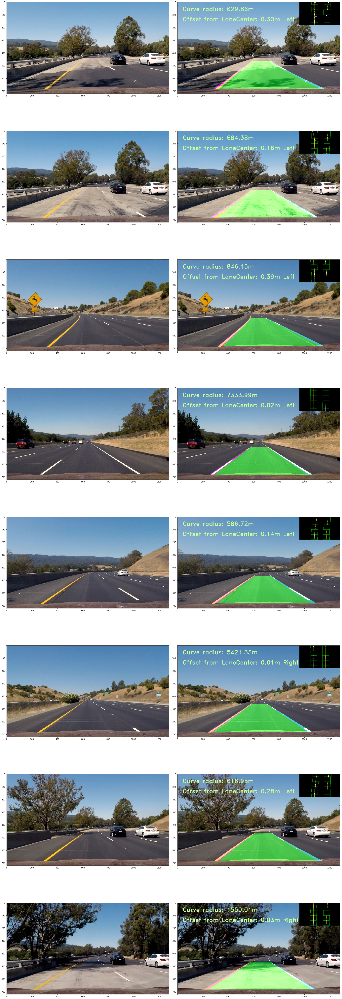

In [7]:
imgList=glob.glob('..//CarND-Advanced-Lane-Lines//test_images//*.jpg')

f, ax = plt.subplots(len(imgList), 2, figsize=(24, 9*len(imgList)))
f.tight_layout()
for i,fname in enumerate(imgList):
    leftLine=Line()
    rightLine=Line()
    img=mpimg.imread(fname)
    res = finalpipline(img)
    ax[i,0].imshow(img)
    ax[i,1].imshow(res)

In [9]:
leftLine=Line()
rightLine=Line()
video_output1 = 'project_video_output.mp4'
video_input1 = VideoFileClip('project_video.mp4')
#processed_video = video_input1.get_frame(28)
#plt.imshow(processed_video)
processed_video = video_input1.fl_image(finalpipline)
#res=finalpipline(processed_video)
#plt.imshow(res)
%time processed_video.write_videofile(video_output1, audio=False)





[MoviePy] >>>> Building video project_video_output.mp4
[MoviePy] Writing video project_video_output.mp4


100%|█████████▉| 1260/1261 [05:05<00:00,  4.27it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_output.mp4 

CPU times: user 2min 53s, sys: 3.04 s, total: 2min 56s
Wall time: 5min 8s


In [10]:
leftLine=Line()
rightLine=Line()
video_output2 = 'challenge_video_output.mp4'
video_input2 = VideoFileClip('challenge_video.mp4')
#processed_video = video_input1.get_frame(28)
#plt.imshow(processed_video)
processed_video = video_input2.fl_image(finalpipline)
#res=finalpipline(processed_video)
#plt.imshow(res)
%time processed_video.write_videofile(video_output2, audio=False)

[MoviePy] >>>> Building video challenge_video_output.mp4
[MoviePy] Writing video challenge_video_output.mp4


100%|██████████| 485/485 [01:53<00:00,  4.16it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: challenge_video_output.mp4 

CPU times: user 1min 5s, sys: 1.29 s, total: 1min 6s
Wall time: 1min 56s


In [11]:
leftLine=Line()
rightLine=Line()
video_output3 = 'harder_challenge_video_output.mp4'
video_input3 = VideoFileClip('harder_challenge_video.mp4')
#processed_video = video_input1.get_frame(28)
#plt.imshow(processed_video)
processed_video = video_input3.fl_image(finalpipline)
#res=finalpipline(processed_video)
#plt.imshow(res)
%time processed_video.write_videofile(video_output3, audio=False)

[MoviePy] >>>> Building video harder_challenge_video_output.mp4
[MoviePy] Writing video harder_challenge_video_output.mp4


100%|█████████▉| 1199/1200 [05:52<00:00,  3.50it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: harder_challenge_video_output.mp4 

CPU times: user 3min 15s, sys: 3.65 s, total: 3min 19s
Wall time: 5min 56s
